<a href="https://colab.research.google.com/github/Nclmnl/prediksi-penggunaan-energi-pada-rumah/blob/main/sdr_mantap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
%matplotlib inline
import seaborn as sns

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [9]:
#load the dataset
url = '/content/drive/MyDrive/NICOLA/data RBL SDRR.xlsx'
energyuse = pd.read_excel(url)
energyuse

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,60,30,19.890000,47.596667,19.200000,44.790000,19.790000,44.730000,19.000000,45.566667,17.166667,55.200000,6.60,733.5,92.000000,7.000000,63.000000,5.3,13.275433,13.275433
1,60,30,19.890000,46.693333,19.200000,44.722500,19.790000,44.790000,19.000000,45.992500,17.166667,55.200000,6.48,733.6,92.000000,6.666667,59.166667,5.2,18.606195,18.606195
2,50,30,19.890000,46.300000,19.200000,44.626667,19.790000,44.933333,18.926667,45.890000,17.166667,55.090000,6.37,733.7,92.000000,6.333333,55.333333,5.1,28.642668,28.642668
3,50,40,19.890000,46.066667,19.200000,44.590000,19.790000,45.000000,18.890000,45.723333,17.166667,55.090000,6.25,733.8,92.000000,6.000000,51.500000,5.0,45.410390,45.410390
4,60,40,19.890000,46.333333,19.200000,44.530000,19.790000,45.000000,18.890000,45.530000,17.200000,55.090000,6.13,733.9,92.000000,5.666667,47.666667,4.9,10.084097,10.084097
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19730,100,0,25.566667,46.560000,25.890000,42.025714,27.200000,41.163333,24.700000,45.590000,23.200000,52.400000,22.70,755.2,55.666667,3.333333,23.666667,13.3,43.096812,43.096812
19731,90,0,25.500000,46.500000,25.754000,42.080000,27.133333,41.223333,24.700000,45.590000,23.230000,52.326667,22.60,755.2,56.000000,3.500000,24.500000,13.3,49.282940,49.282940
19732,270,10,25.500000,46.596667,25.628571,42.768571,27.050000,41.690000,24.700000,45.730000,23.230000,52.266667,22.50,755.2,56.333333,3.666667,25.333333,13.3,29.199117,29.199117
19733,420,10,25.500000,46.990000,25.414000,43.036000,26.890000,41.290000,24.700000,45.790000,23.200000,52.200000,22.30,755.2,56.666667,3.833333,26.166667,13.2,6.322784,6.322784


In [10]:
energyuse.shape

(19735, 20)

Output kode di atas memberikan informasi sebagai berikut:

Ada 19735 baris records dalam dataset. Terdapat 29 kolom yaitu: date, Appliances, lights, T1, RH_1, T2, RH_2, T3, RH_3, T4, RH_4, T5, RH_5, T_out, Pressure, RH_out, Windspeed, Visibility, Tdewpoint, rv1, rv2

# **Exploratory Data Analysis**
# Deskripsi Variabel

* lights, energy use of light fixtures in the house in Wh
* T1, Temperature in kitchen area, in Celsius
* RH_1, Humidity in kitchen area, in %
* T2, Temperature in living room area, in Celsius
* RH_2, Humidity in living room area, in %
* T3, Temperature in laundry room area
* RH_3, Humidity in laundry room area, in %
* T4, Temperature in office room, in Celsius
* RH_4, Humidity in office room, in %
* T5, Temperature in bathroom, in Celsius
* RH_5, Humidity in bathroom, in %
* T6, Temperature outside the building (north side), in Celsius
* RH_6, Humidity outside the building (north side), in %
* T7, Temperature in ironing room , in Celsius
* RH_7, Humidity in ironing room, in %
* T8, Temperature in teenager room 2, in Celsius
* RH_8, Humidity in teenager room 2, in %
* T9, Temperature in parents room, in Celsius
* RH_9, Humidity in parents room, in %
* To, Temperature outside (from Chievres weather station), in Celsius
* Pressure (from Chievres weather station), in mm Hg
* RH_out, Humidity outside (from Chievres weather station), in %
* Wind speed (from Chievres weather station), in m/s
* Visibility (from Chievres weather station), in km
* Tdewpoint (from Chievres weather station), Â°C
* rv1, Random variable 1, nondimensional
* rv2, Random variable 2, nondimensional

In [11]:
energyuse.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 20 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Appliances   19735 non-null  int64  
 1   lights       19735 non-null  int64  
 2   T1           19735 non-null  float64
 3   RH_1         19735 non-null  float64
 4   T2           19735 non-null  float64
 5   RH_2         19735 non-null  float64
 6   T3           19735 non-null  float64
 7   RH_3         19735 non-null  float64
 8   T4           19735 non-null  float64
 9   RH_4         19735 non-null  float64
 10  T5           19735 non-null  float64
 11  RH_5         19735 non-null  float64
 12  T_out        19735 non-null  float64
 13  Press_mm_hg  19735 non-null  float64
 14  RH_out       19735 non-null  float64
 15  Windspeed    19735 non-null  float64
 16  Visibility   19735 non-null  float64
 17  Tdewpoint    19735 non-null  float64
 18  rv1          19735 non-null  float64
 19  rv2 

Dari output terlihat bahwa:

Tidak terdapat kolom dengan tipe object, yang merupakan categorical features (fitur non-numerik).

Terdapat 18 kolom numerik dengan tipe data float64 yaitu: T1, RH_1, T2, RH_2,	T3,	RH_3,	T4,	RH_4, T5, RH_5, T6, RH_6, T7, RH_7, T8, RH_8,	T9,	RH_9,	T_out,	Pressure,	RH_out,	Windspeed, Visibility,	Tdewpoint,	rv1,	rv2.

Terdapat 2 kolom numerik dengan tipe data int64, yaitu: Appliances, dan lights.

In [12]:
energyuse.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,19.592106,50.949283,7.412580,755.522602,79.750418,4.039752,38.330834,3.760995,24.988033,24.988033
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,1.844623,9.022034,5.318464,7.399441,14.901088,2.451221,11.794719,4.195248,14.496634,14.496634
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,15.330000,29.815000,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,18.277500,45.400000,3.670000,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,19.390000,49.090000,6.920000,756.100000,83.666667,3.666667,40.000000,3.430000,24.897653,24.897653
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,20.619643,53.663333,10.400000,760.933333,91.666667,5.500000,40.000000,6.570000,37.583769,37.583769
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,25.795000,96.321667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


Fungsi describe() memberikan informasi statistik pada masing-masing kolom, antara lain:

Count adalah jumlah sampel pada data.
Mean adalah nilai rata-rata.
Std adalah standar deviasi.
Min yaitu nilai minimum setiap kolom.
25% adalah kuartil pertama. Kuartil adalah nilai yang menandai batas interval dalam empat bagian sebaran yang sama.
50% adalah kuartil kedua, atau biasa juga disebut median (nilai tengah).
75% adalah kuartil ketiga.
Max adalah nilai maksimum.

#**Data Assesing**
# Data Duplikat


In [13]:
energyuse.duplicated().sum()

0

# Misingg Value

In [14]:
energyuse.isna().sum()

Appliances     0
lights         0
T1             0
RH_1           0
T2             0
RH_2           0
T3             0
RH_3           0
T4             0
RH_4           0
T5             0
RH_5           0
T_out          0
Press_mm_hg    0
RH_out         0
Windspeed      0
Visibility     0
Tdewpoint      0
rv1            0
rv2            0
dtype: int64

#**Data Cleaning**
# Imputation
Berdasarkan pengujian yang dilakukan, tidak terdapat data null sehingga tidak perlu dilakukan imputasi dengan mengganti nilai null dengan nilai mean




# Menangani Outliers
Beberapa pengamatan dalam satu set data kadang berada di luar lingkungan pengamatan lainnya. Pengamatan seperti itu disebut outlier.

Ada beberapa teknik untuk menangani outliers, antara lain:
*   Hypothesis Testing
*   Z-score method
*   IQR Method


Z-score method
IQR Method

Pada kasus ini, Anda akan mendeteksi outliers dengan teknik visualisasi data (boxplot). Kemudian, Anda akan menangani outliers dengan teknik IQR method

IQR = Inter Quartile Range

IQR = Q3 - Q1.

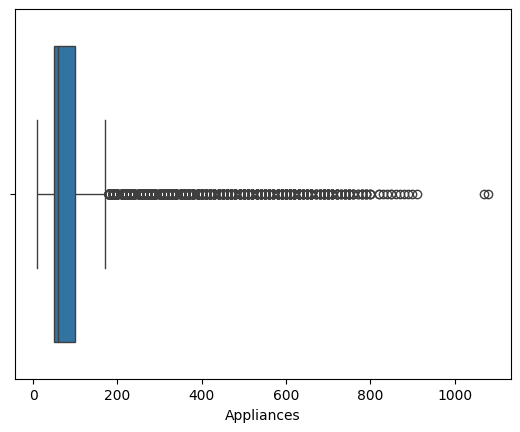

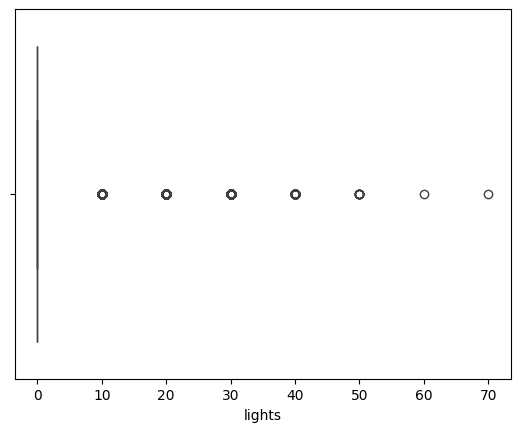

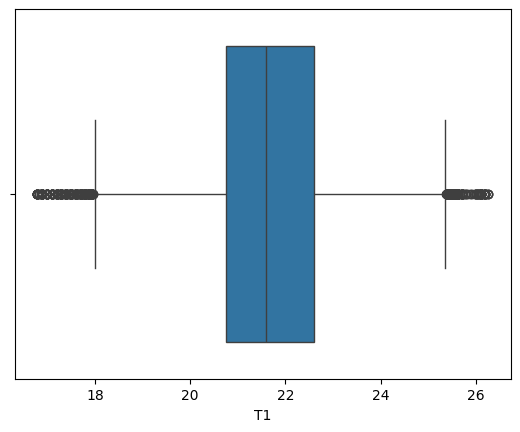

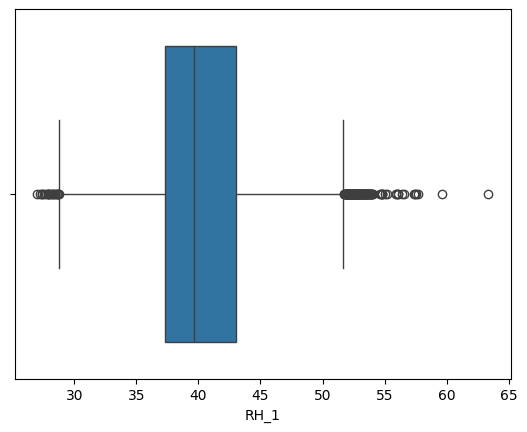

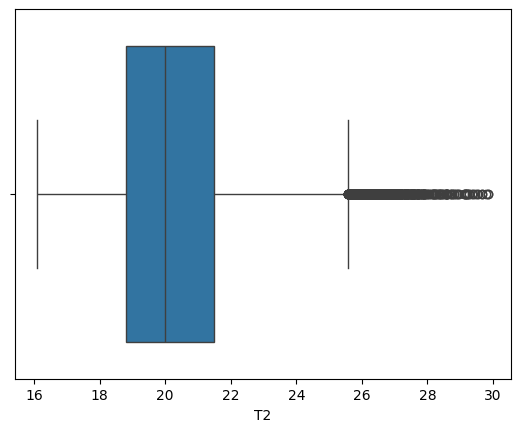

...

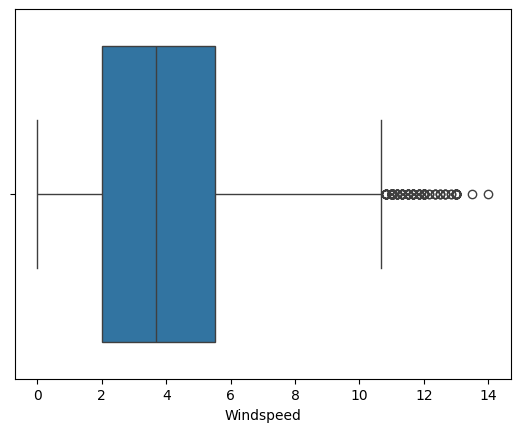

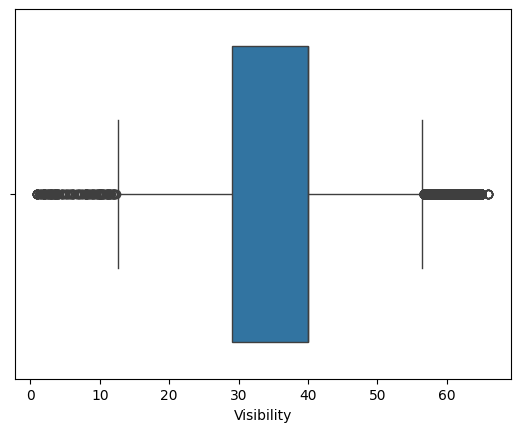

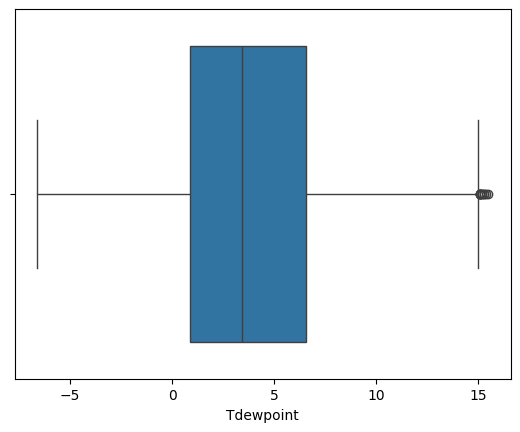

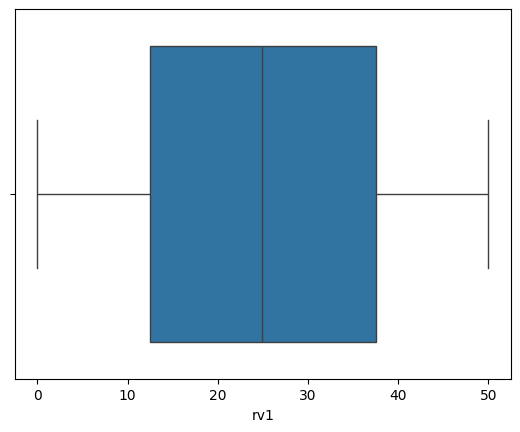

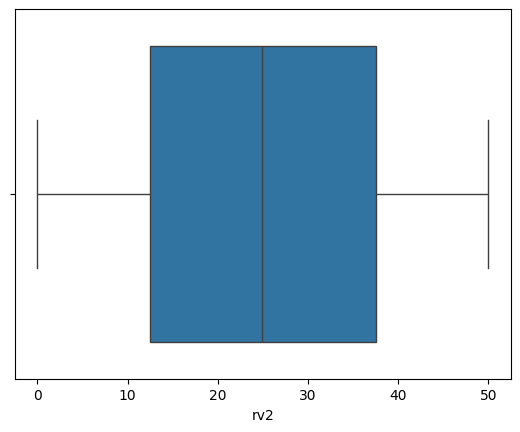

In [15]:
energyuse1=energyuse.select_dtypes(exclude=['object'])
for column in energyuse1:
        plt.figure()
        sns.boxplot(data=energyuse1, x=column)

In [17]:
Q1 = energyuse.quantile(0.25)
Q3 = energyuse.quantile(0.75)
IQR=Q3-Q1

energyuse = energyuse[~((energyuse<(Q1-1.5*IQR))|(energyuse>(Q3+1.5*IQR))).any(axis=1)]

Cek ukuran dataset setelah drop outliers dengan housing.shape

In [18]:
energyuse.shape

(9160, 20)

Dataset sekarang telah bersih dan memiliki 9160 sampel.

#**Data Analysis**

Selanjutnya, lakukan proses analisis data dengan teknik Univariate EDA. Pertama, Anda bagi fitur pada dataset menjadi dua bagian, yaitu numerical features dan categorical features.

In [19]:
categorical_features = ['date']
numerical_features = ['T1', 'RH_1', 'T2', 'RH_2', 'T3', 'RH_3', 'T4', 'RH_4', 'T5', 'RH_5', 'T6', 'RH_6', 'T7', 'RH_7', 'T8', 'RH_8', 'T9', 'RH_9', 'T_out', 'Pressure', 'RH_out', 'Windspeed', 'Visibility', 'Tdewpoint', 'rv1', 'rv2']


# Univariate Analysis
Univariate visualization merupakan bentuk visualisasi data yang hanya merepresentasikan informasi yang terdapat pada satu variabel. Jenis visualisasi ini umumnya digunakan untuk memberikan gambaran terkait distribusi sebuah variabel dalam suatu dataset.

a. Data Kategori

Tidak terdapat data kategorik

b. Data Numerik


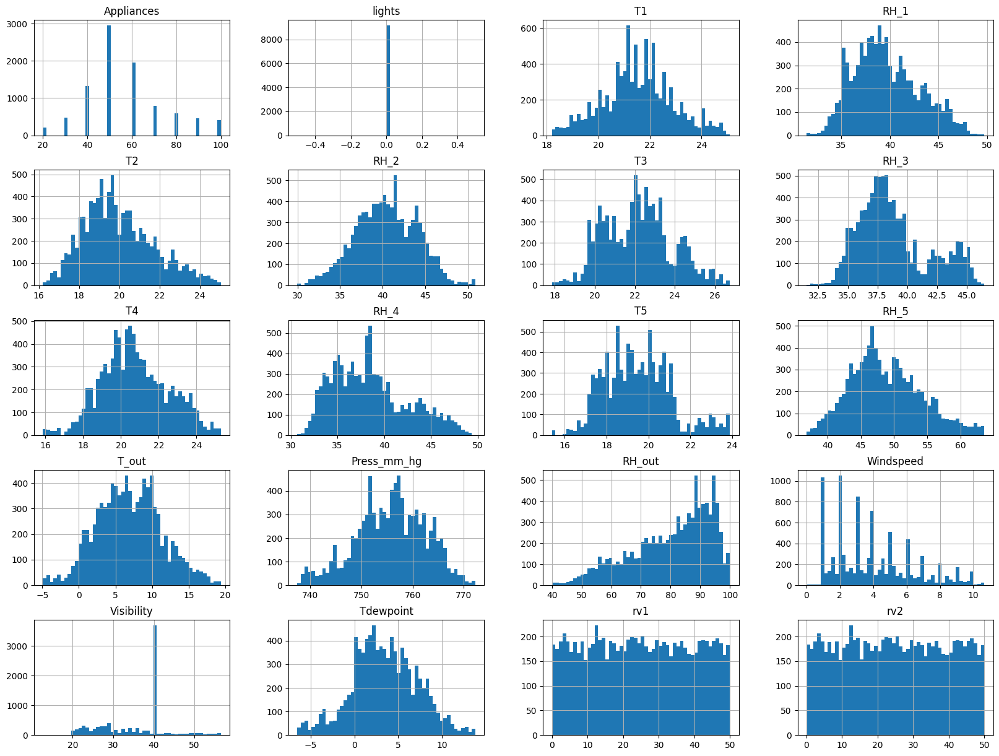

In [22]:
energyuse.hist(bins=50, figsize=(20,15))
plt.show()

# Multivariate Analysis

Multivariate visualization merupakan jenis visualisasi data untuk menggambarkan informasi yang terdapat dalam lebih dari dua variabel. Jenis visualisasi ini digunakan untuk merepresentasikan hubungan dan pola yang terdapat dalam multidimensional data.

Pada tahap ini,cek rata-rata "appliances" terhadap masing-masing fitur untuk mengetahui pengaruh fitur kategori terhadap "appliances".

a. Data Kategori

Tidak terdapat data kategorik

b. Data Numerik

Mengamati hubungan antar fitur numerik dengan fungsi pairplot()

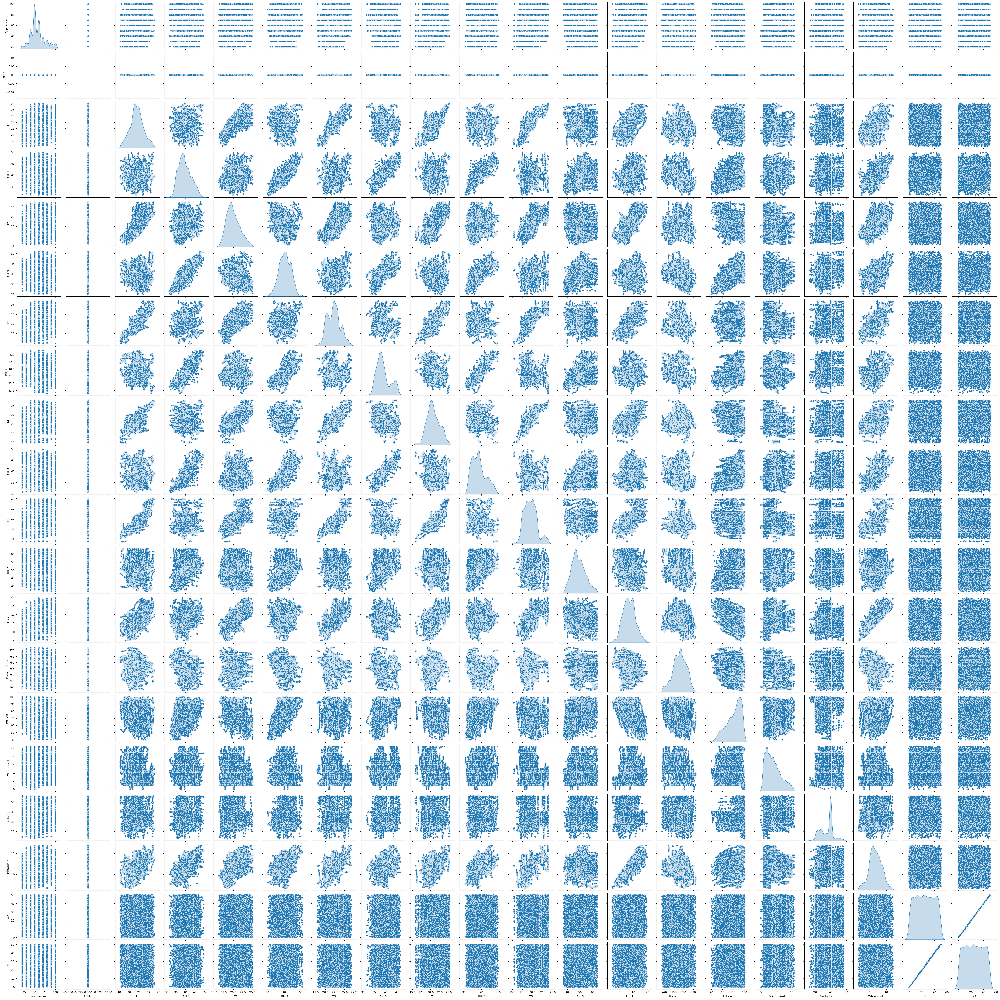

In [24]:
sns.pairplot(energyuse, diag_kind = 'kde')

Fungsi pairplot dari library seaborn menunjukkan relasi pasangan dalam dataset.

Koefisien korelasi berkisar antara -1 dan +1. Ia mengukur kekuatan hubungan antara dua variabel serta arahnya (positif atau negatif). Mengenai kekuatan hubungan antar variabel, semakin dekat nilainya ke 1 atau -1, korelasinya semakin kuat. Sedangkan, semakin dekat nilainya ke 0, korelasinya semakin lemah

Untuk mengevaluasi skor korelasinya, gunakan fungsi corr().

Text(0.5, 1.0, 'Correlation Matrix untuk Fitur Numerik ')

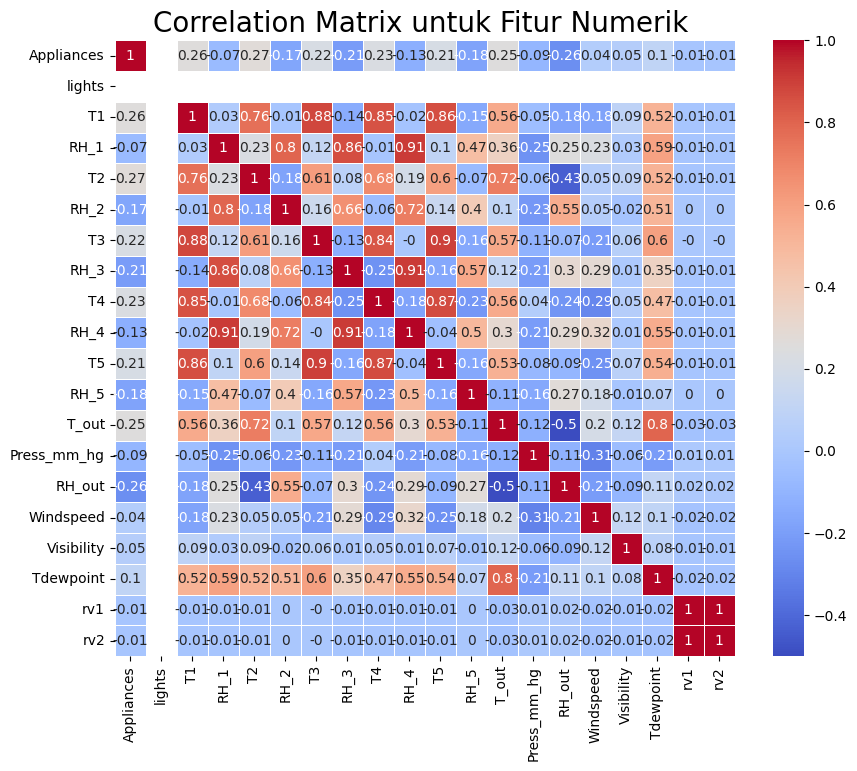

In [25]:
plt.figure(figsize=(10, 8))
correlation_matrix = energyuse.corr().round(2)
sns.heatmap(data=correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, )
plt.title("Correlation Matrix untuk Fitur Numerik ", size=20)

Jika diamati, fitur 'T2' memiliki skor korelasi yang cukup besar (0.27) dengan fitur target 'Appliances'. Artinya, fitur 'Appliances' berkorelasi cukup tinggi dengan lima belas fitur tersebut. Sementara itu, fitur lainnya memiliki korelasi negatif sehingga, fitur tersebut dapat di-drop.

In [27]:
energyuse.drop(['rv1', 'rv2'], inplace=True, axis=1)
energyuse.head()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,RH_5,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint
51,50,0,20.926667,45.590000,20.29,44.290000,20.166667,45.530,21.890000,46.966667,19.000000,50.0300,5.15,737.900000,92.0,5.500000,40.0,3.95
52,40,0,20.890000,45.666667,20.23,44.290000,20.133333,45.500,21.823333,46.226667,18.926667,50.0900,5.17,738.033333,92.0,5.333333,40.0,3.97
53,50,0,20.890000,46.060000,20.20,44.400000,20.200000,45.500,21.666667,46.060000,18.890000,50.0900,5.18,738.166667,92.0,5.166667,40.0,3.98
54,40,0,20.790000,46.200000,20.20,44.466667,20.166667,45.500,21.533333,45.933333,18.890000,50.1725,5.20,738.300000,92.0,5.000000,40.0,4.00
55,50,0,20.790000,46.200000,20.10,44.530000,20.125000,45.425,21.356667,45.900000,18.890000,50.2000,5.13,738.400000,92.0,4.833333,40.0,3.93


#** Data Preparation**
Data Peparation merupakan tahapan penting dalam proses pengembangan model machine learning. Pada tahap ini lakukan proses transformasi pada data sehingga menjadi bentuk yang cocok untuk proses pemodelan. Ada beberapa tahapan yang umum dilakukan pada data preparation, antara lain, seleksi fitur, transformasi data, feature engineering, dan dimensionality reduction.

Pada bagian ini lakukan empat tahap persiapan data, yaitu:

* Encoding fitur kategori.
* Reduksi dimensi dengan Principal Component Analysis (PCA).
* Pembagian dataset dengan fungsi train_test_split dari library sklearn.
* Standarisasi.

# Encoding
Untuk melakukan proses encoding fitur kategori, salah satu teknik yang umum dilakukan adalah teknik one-hot-encoding. Lakukan proses encoding ini dengan fitur get_dummies.

# Reduksi Dimensi dengan PCA
Teknik reduksi (pengurangan) dimensi adalah prosedur yang mengurangi jumlah fitur dengan tetap mempertahankan informasi pada data. Teknik pengurangan dimensi yang paling populer adalah Principal Component Analysis atau disingkat menjadi PCA. Ia adalah teknik untuk mereduksi dimensi, mengekstraksi fitur, dan mentransformasi data dari “n-dimensional space” ke dalam sistem berkoordinat baru dengan dimensi m, di mana m lebih kecil dari n.

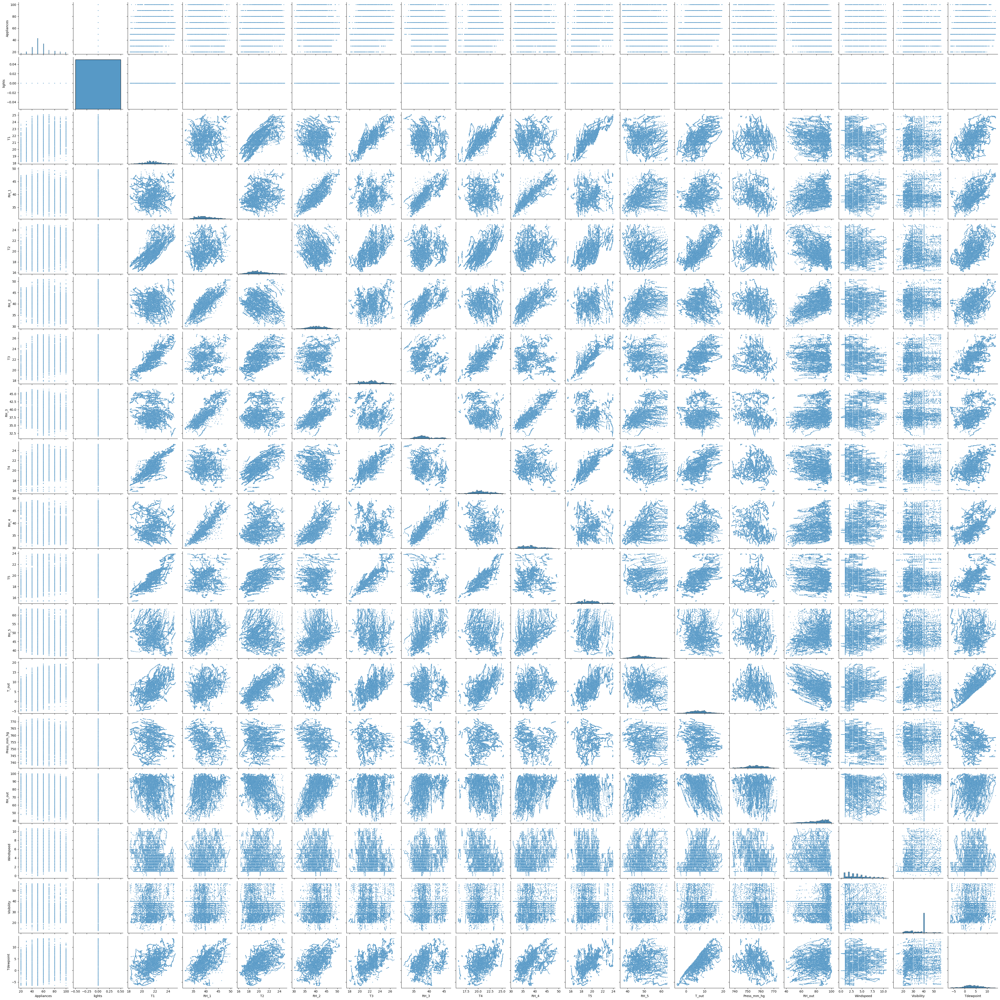

In [29]:
sns.pairplot(energyuse[['Appliances',	'lights',	'T1',	'RH_1',	'T2',	'RH_2',	'T3',	'RH_3',	'T4',	'RH_4',	'T5',	'RH_5',	'T_out',	'Press_mm_hg',	'RH_out',	'Windspeed',	'Visibility',	'Tdewpoint']], plot_kws={"s": 4});

Berdasarkan hasil visualisasi dapat diketahui yang memiliki hubungan antar fitur hanya tiga yaitu 'T1', 'T2', 'T3', 'T4', 'T5', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'Tdewpoint', 'T_out'.

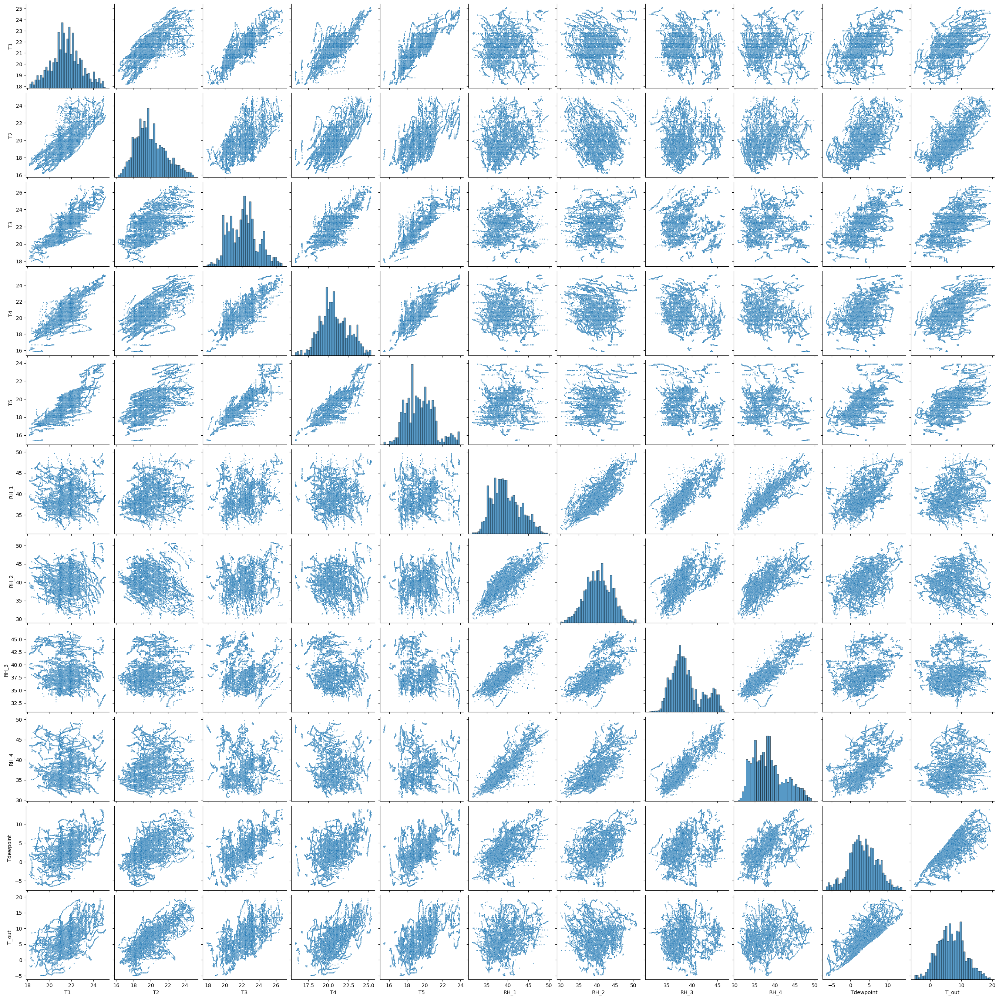

In [33]:
sns.pairplot(energyuse[['T1', 'T2', 'T3', 'T4', 'T5', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'Tdewpoint', 'T_out']], plot_kws={"s": 3});

Selanjutnya, reduksi 11 fitur ini dengan PCA

In [34]:
from sklearn.decomposition import PCA

pca = PCA(n_components=11, random_state=123)
pca.fit(energyuse[['T1', 'T2', 'T3', 'T4', 'T5', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'Tdewpoint', 'T_out']])
princ_comp = pca.transform(energyuse[['T1', 'T2', 'T3', 'T4', 'T5', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'Tdewpoint', 'T_out']])


Setelah menerapkan class PCA, cek proporsi informasi dari 11 komponen PCs tadi.


In [35]:
pca.explained_variance_ratio_.round(3)

array([0.555, 0.287, 0.074, 0.04 , 0.018, 0.009, 0.008, 0.004, 0.003,
       0.002, 0.001])

Dari output di atas 55.5% informasi pada ketiga fitur 'T1', 'T2', 'T3', 'T4', 'T5', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'Tdewpoint', 'T_out' terdapat pada PC pertama.

Berdasarkan hasil ini, reduksi fitur (dimensi) dan hanya mempertahankan PC (komponen) pertama saja. PC pertama ini akan menjadi fitur 'energy' menggantikan fitur lainnya ('T1', 'T2', 'T3', 'T4', 'T5', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'Tdewpoint', 'T_out'). Beri nama fitur ini 'energy'

In [37]:
from sklearn.decomposition import PCA
pca = PCA(n_components=1, random_state=123)
pca.fit(energyuse[['T1', 'T2', 'T3', 'T4', 'T5', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'Tdewpoint', 'T_out']])
energyuse['energy'] = pca.transform(energyuse.loc[:, ('T1', 'T2', 'T3', 'T4', 'T5', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'Tdewpoint', 'T_out')]).flatten()
energyuse.drop(['T1', 'T2', 'T3', 'T4', 'T5', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'Tdewpoint', 'T_out'], axis=1, inplace=True)
energyuse.head()

,Appliances,lights,RH_5,Press_mm_hg,RH_out,Windspeed,Visibility,energy
51,50,0,50.0300,737.900000,92.0,5.500000,40.0,9.390919
52,40,0,50.0900,738.033333,92.0,5.333333,40.0,9.055811
53,50,0,50.0900,738.166667,92.0,5.166667,40.0,9.181672
54,40,0,50.1725,738.300000,92.0,5.000000,40.0,9.205443
55,50,0,50.2000,738.400000,92.0,4.833333,40.0,9.109823


Train-Test-Split
Membagi dataset menjadi data latih (train) dan data uji (test) merupakan hal yang harus diakukan sebelum membuat model. Hal ini diperlukan untuk menguji seberapa baik generalisasi model terhadap data baru.

In [38]:
from sklearn.model_selection import train_test_split

X = energyuse.drop(["Appliances"],axis =1)
y = energyuse["Appliances"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.1, random_state = 123)


In [39]:
print(f'Total # of sample in whole dataset: {len(X)}')
print(f'Total # of sample in train dataset: {len(X_train)}')
print(f'Total # of sample in test dataset: {len(X_test)}')

Total # of sample in whole dataset: 9160
Total # of sample in train dataset: 8244
Total # of sample in test dataset: 916


# Standarisasi
Algoritma machine learning memiliki performa lebih baik dan lebih cepat ketika dimodelkan pada data dengan yang mendekati distribusi normal. Scaling dan standarisasi merupakan metode yang dapat dilakukan

Untuk fitur numerik, tidak dilakukan proses transformasi dengan one-hot-encoding seperti pada fitur kategori. Yang digunakan untuk standarisasi adalah StandarScaler.

StandardScaler merupakan proses standarisasi fitur dengan mengurangkan mean kemudian membaginya dengan standar deviasi untuk menggeser distribusi. StandardScaler menghasilkan distribusi dengan standar deviasi sama dengan 1 dan mean sama dengan 0.

In [47]:
from sklearn.preprocessing import StandardScaler

numerical_features = ['lights',	'RH_5',	'Press_mm_hg',	'RH_out',	'Windspeed',	'Visibility',	'energy']
scaler = StandardScaler()
scaler.fit(X_train[numerical_features])
X_train[numerical_features] = scaler.transform(X_train.loc[:, numerical_features])
X_train[numerical_features].head()

,lights,RH_5,Press_mm_hg,RH_out,Windspeed,Visibility,energy
11175,0.0,-0.411806,-0.981679,0.389638,1.671873,0.582138,-0.109741
7668,0.0,0.196969,-2.264720,0.880903,-1.251143,-1.478402,-0.986079
13949,0.0,0.845870,0.043280,-0.252787,0.140769,0.582138,-0.080488
18553,0.0,-0.347634,-0.170560,-1.978515,-0.903165,0.582138,0.732190
4244,0.0,0.394741,-2.461355,0.906096,2.228638,0.582138,0.075358


Seperti yang telah disebutkan sebelumnya, proses standarisasi mengubah nilai rata-rata (mean) menjadi 0 dan nilai standar deviasi menjadi 1. Untuk itu perlu dicek nilai mean dan standar deviasi pada setelah proses standarisasi.

In [48]:
X_train[numerical_features].describe().round(4)

,lights,RH_5,Press_mm_hg,RH_out,Windspeed,Visibility,energy
count,8244.0,8244.0000,8244.0000,8244.0000,8244.0000,8244.0000,8244.0000
mean,0.0,-0.0000,0.0000,0.0000,0.0000,-0.0000,0.0000
std,0.0,1.0001,1.0001,1.0001,1.0001,1.0001,1.0001
min,0.0,-2.2384,-2.6924,-3.0492,-1.6687,-2.7309,-2.2209
25%,0.0,-0.7149,-0.6523,-0.6559,-0.8336,-0.8724,-0.8466
50%,0.0,-0.1359,0.0654,0.2511,-0.1376,0.5821,-0.0254
75%,0.0,0.6510,0.7290,0.8053,0.6279,0.5821,0.6717
max,0.0,2.7598,2.4324,1.4855,2.7854,2.5821,2.8906


Berdasarkan tabel di atas, sekarang nilai mean = 0 dan standar deviasi = 1.0001

#**Model Development**
Model development adalah tahapan dimana digunakan algoritma machine learning untuk menjawab problem statement dari tahap business understanding Pada tahap ini, dibuat model machine learning dengan tiga algoritma. Kemudian, evaluasi performa masing-masing algoritma dan pilih algoritma mana yang memberikan hasil prediksi terbaik. Ketiga algoritma yang akan digunakan, antara lain:

Regresi Linier
Regresi Ridge
Random Forest
Random Forest dengan Tuning GridSearchCV

In [49]:
#Siapkan dataframe untuk analisis model
models = pd.DataFrame(index=['train_mse', 'test_mse'],
                      columns=['LinearRegression', 'RidgeRegression', 'RandomForest', 'RandomForest_GridSearchCV'])


# 1. Regresi Linear

Regresi linear adalah teknik analisis data yang memprediksi nilai data yang tidak diketahui dengan menggunakan nilai data lain yang terkait dan diketahui.

In [50]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import accuracy_score, r2_score, mean_absolute_error, mean_squared_error

LR = LinearRegression()
LR.fit(X_train, y_train)
print ('Coefficients: ', LR .coef_)
print ('Intercept: ', LR .intercept_)
models.loc['train_mse','Linear Regression'] = mean_squared_error(y_pred = LR.predict(X_train), y_true=y_train)


Coefficients:  [ 0.         -2.49561662 -2.32112367 -4.51963237 -0.68107844  0.42230571
  1.12593195]
Intercept:  56.870451237263495


# 2. Ridge Regression
Regresi Ridge merupakan metode estimasi koefisien regresi yang diperoleh melalui penambahan konstanta bias sehingga diperoleh persamaan regresi linier yang baru dan tidak mengandung multikolinieritas

In [51]:
from sklearn.linear_model import Ridge
RR = Ridge()
RR.fit(X_train, y_train)
models.loc['train_mse','Ridge Regression'] = mean_squared_error(y_pred = RR.predict(X_train), y_true=y_train)


# 3. Random Forest
Algoritma random forest dapat digunakan untuk menyelesaikan masalah klasifikasi dan regresi. Random forest juga merupakan algoritma yang sering digunakan karena cukup sederhana tetapi memiliki stabilitas yang mumpuni.

In [52]:
#Impor library yang dibutuhkan
from sklearn.ensemble import RandomForestRegressor

#buat model prediksi
RF1 = RandomForestRegressor(random_state=100)
RF1.fit(X_train, y_train)
models.loc['train_mse','Random Forest'] = mean_squared_error(y_pred=RF1.predict(X_train), y_true=y_train)


# 4. Random Forest dengan Tuning GridSearchCV
Untuk meningkatkan model, dilakukan eksperimen dengan menggunakan GridSearchCV untuk melakukan hyperparameter tuning pada Random Forest

Berikut adalah hyperparameter yang digunakan:

* n_estimator: jumlah trees (pohon) di forest
* max_depth: kedalaman atau panjang pohon. Ia merupakan ukuran seberapa banyak pohon dapat membelah (splitting) untuk membagi setiap node ke dalam jumlah pengamatan yang diinginkan.
* min_samples_split menentukan jumlah minimum sampel yang diperlukan untuk memisahkan simpul internal
* min_samples_leafmenentukan jumlah minimum sampel yang diperlukan untuk berada di simpul daun

In [53]:
params = {'n_estimators' : [50,80,100],
          'max_depth' : [3,5,10],
           'min_samples_split':[2,3,4],
            'min_samples_leaf': [2,3,4]}

In [54]:
from sklearn.model_selection import GridSearchCV

grid = GridSearchCV(estimator= RF1 , param_grid=params, cv=3, scoring='r2')
grid.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=RandomForestRegressor(random_state=100),
             param_grid={'max_depth': [3, 5, 10], 'min_samples_leaf': [2, 3, 4],
                         'min_samples_split': [2, 3, 4],
                         'n_estimators': [50, 80, 100]},
             scoring='r2')

In [55]:
grid.best_params_

{'max_depth': 10,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 100}

In [56]:
RF2 = RandomForestRegressor(max_depth =10,min_samples_leaf = 4,min_samples_split = 2,n_estimators = 100,random_state=100)
RF2.fit(X_train, y_train)
models.loc['train_mse','Random Forest'] = mean_squared_error(y_pred=RF2.predict(X_train), y_true=y_train)


#**Evaluasi Model**
Sekarang, setelah model selesai dilatih dengan 4 algoritma, selanjutnya lihat performa model dengan menggunakan metrik evaluasi

In [57]:
def metrics(name,key,arg):
    print('Name of the model: ',name)
    print('R^2 of the model:',r2_score(key,arg))
    print('MSE of the model:',np.sqrt(mean_squared_error(key,arg)))
    print('MAE of the model:',mean_absolute_error(key,arg))
    print('......')

In [58]:
y_LR = LR.predict(X_test)
y_RR = RR.predict(X_test)
y_RF1 = RF1.predict(X_test)
y_RF2 = RF2.predict(X_test)

metrics('Performa Model 1', y_test, y_LR)
metrics('Performa Model 2', y_test, y_RR)
metrics('Performa Model 3', y_test, y_RF1)
metrics('Performa Model 4', y_test, y_RF2)

Name of the model:  Performa Model 1
R^2 of the model: -15822.820235231844
MSE of the model: 2228.819631272838
MAE of the model: 2227.9828068264883
......
Name of the model:  Performa Model 2
R^2 of the model: -15817.222070472248
MSE of the model: 2228.425339531574
MAE of the model: 2227.5886009970973
......
Name of the model:  Performa Model 3
R^2 of the model: -0.39805276219466124
MSE of the model: 20.949855654993556
MAE of the model: 15.656659388646288
......
Name of the model:  Performa Model 4
R^2 of the model: -0.36461941323745206
MSE of the model: 20.697840062675287
MAE of the model: 15.21291054892845
......


Melakukan proses scaling terhadap data uji. Hal ini harus dilakukan agar skala antara data latih dan data uji sama dan bisa dilakukan evaluasi.

Lakukan scaling terhadap fitur numerik pada X_test sehingga memiliki rata-rata=0 dan varians=1

In [59]:
X_test.loc[:, numerical_features] = scaler.transform(X_test[numerical_features])

<ipython-input-59-0615151fc0c1>:1: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  X_test.loc[:, numerical_features] = scaler.transform(X_test[numerical_features])


In [60]:
# Buat variabel mse yang isinya adalah dataframe nilai mse data train dan test pada masing-masing algoritma
mse = pd.DataFrame(columns=['train', 'test'], index=['LR','RR','RF1', 'RF2'])

# Buat dictionary untuk setiap algoritma yang digunakan
model_dict = {'LR': LR, 'RR': RR, 'RF1': RF1, 'RF2': RF2}

# Hitung Mean Squared Error masing-masing algoritma pada data train dan test
for name, model in model_dict.items():
    mse.loc[name, 'train'] = mean_squared_error(y_true=y_train, y_pred=model.predict(X_train))/1e3
    mse.loc[name, 'test'] = mean_squared_error(y_true=y_test, y_pred=model.predict(X_test))/1e3

# Panggil mse
mse

,train,test
LR,0.282713,0.281859
RR,0.282713,0.281859
RF1,0.018622,0.132265
RF2,0.132098,0.180795


Untuk memudahkan, plot metrik tersebut dengan bar chart, diimplementasikan kode di bawah ini:

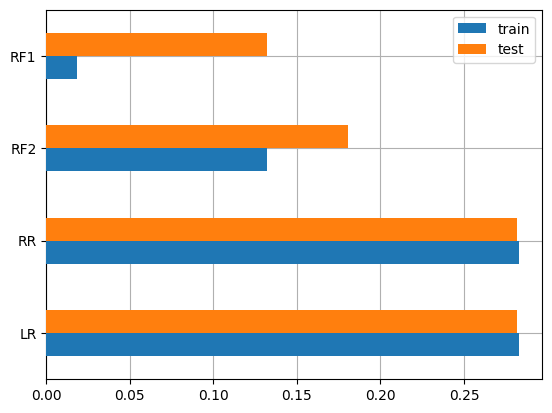

In [61]:
fig, ax = plt.subplots()
mse.sort_values(by='test', ascending=False).plot(kind='barh', ax=ax, zorder=3)
ax.grid(zorder=0)

Untuk mengujinya, buat prediksi menggunakan beberapa harga dari data test.

In [62]:
prediksi = X_test.iloc[:1].copy()
pred_dict = {'y_true':y_test[:1]}
for name, model in model_dict.items():
    pred_dict['prediksi_'+name] = model.predict(prediksi).round(1)

pd.DataFrame(pred_dict)


,y_true,prediksi_LR,prediksi_RR,prediksi_RF1,prediksi_RF2
6291,80,49.2,49.2,56.9,54.0


Terlihat bahwa prediksi dengan Random Forest (RF), baik RF1 ataupun RF2 memberikan hasil yang paling mendekati y_true.